# Spacell Validation Tutorial

In this tutorial we will see how to use the spacell validation tool and how it works. This validation tool is for quantifying clustering results against pathologist annotations. In this tutorial we will be using the sample data provided with the package.

## How-To 

To run the validation code from the command line on the sample dataset, use this: 

`python spacell_validation.py -a annotation.png -w wsi_10x_downscale.jpeg -m transformation_matrix.txt -o output -k cluster_predictions.tsv -c 0 0 170 160 160 255 -t -f 10`

For more information on what the different parameters are, please refer to the package README file

## How it works

This code below is an interactive demonstration of what the validation script does.

In [3]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
import os
import pandas as pd
from pathlib import Path
from PIL import Image, ImageOps
import seaborn as sns

#Allow Pillow to open very large images
Image.MAX_IMAGE_PIXELS = None

#Check if OpenCV is using optimised code
cv2.useOptimized()

True

In [26]:
BASE_PATH = os.path.join(os.path.dirname(os.getcwd()), 'dataset', 'validation')

In [27]:
BASE_PATH

'/Users/a.su/Documents/Spacell2/dataset/validation'

Paths for dataset files <br>

Here , for demonstration purposes, we've provided you with a 10x downscaled whole slide image. Whole slide images are usually quite large (e.g. 0.1 - 10 gigapixels) so it is not practical to include the full resolution image in this tutorial. 

In [29]:
ANNOTATION_PATH = os.path.join(BASE_PATH, 'annotation.png')
WSI_SMALL_PATH = os.path.join(BASE_PATH, 'wsi_10x_downscale.jpeg')    #This is our 10x downscaled WSI
CLUSTER_PREDICTIONS_PATH = os.path.join(BASE_PATH, 'cluster_predictions.tsv')

In [30]:
def imshow(img_bgr):
    """Displays OpenCV image with Pillow
    """
    img_rgb = img_bgr[:, :, ::-1]    #Convert from BGR to RGB
    return Image.fromarray(img_rgb)

In [31]:
annotation = cv2.imread(ANNOTATION_PATH)

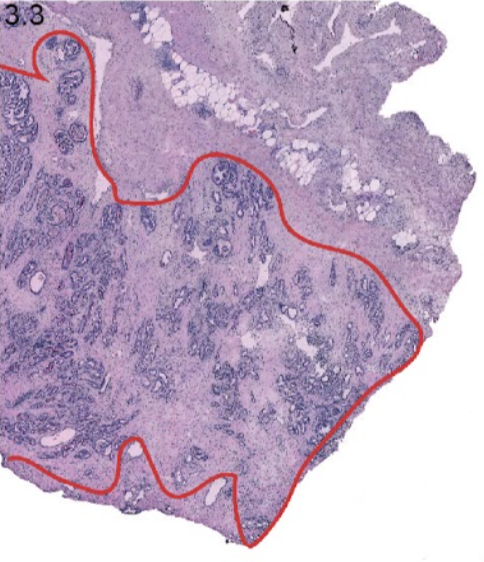

In [32]:
imshow(annotation)

## Detect Annotations

First we need to extract the annotations from our annotation image. Here we use threshold values suitable for the red annotation line. For a different annotation colour you can experiment with other values. <br>

The Threshold values are in order:
* Blue channel lower threshold = `0`
* Green channel lower threshold = `0`
* Red channel lower threshold = `170`
* Blue channel upper threshold = `160`
* Green channel upper threshold = `160`
* Red channel upper threshold = `255`

For further details refer to the <a href="https://docs.opencv.org/3.4/da/d97/tutorial_threshold_inRange.html">inRange</a> function

In [33]:
#Generate Binary mask of annotation
annotation_mask = cv2.inRange(annotation, (0, 0, 170), (160, 160, 255))

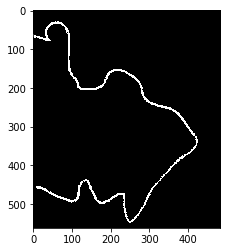

In [34]:
plt.imshow(annotation_mask, cmap = 'gray')

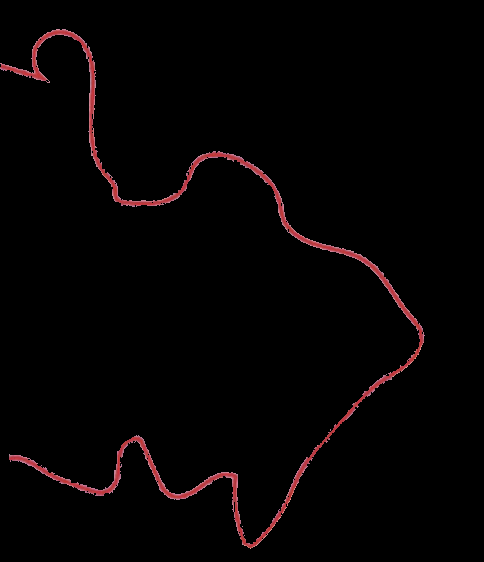

In [457]:
#Apply mask to annotation image
imshow(annotation*np.dstack([annotation_mask,annotation_mask,annotation_mask]))

## Fill in Annotated Area

In this image we have an annotated area which to fill in. In this case it's an open annotated area which is more difficult than a closed annotated area. So we must first close the annoated area to fill it in. Spacell supports both open and closed annotated areas. <br> 

Here we will identify the contour that needs to be filled in. Opencv finds many contours so here we have selected the longest contour, Spacell will automatically do this for you. 

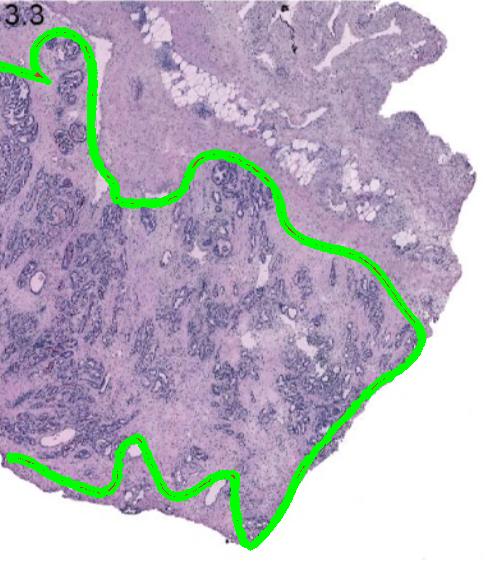

In [39]:
annotation_mask
contours, hierachy = cv2.findContours(annotation_mask.astype(np.uint8), cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
cnt = contours[1]
annotation_contour = cv2.drawContours(annotation.copy(), [cnt], 0, (0,255,0), 3)
imshow(annotation_contour)

To close this open contour, we draw a convex hull around the annotation line. This will provide us with a new boundary for the open edge. 

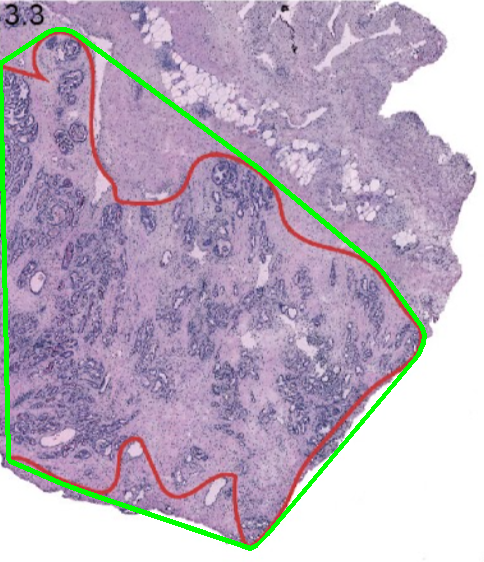

In [40]:
hull = cv2.convexHull(cnt)
annotation_hull = cv2.drawContours(annotation.copy(), [hull], 0, (0, 255, 0), 3)
imshow(annotation_hull)

Let's turn this convex hull into a mask

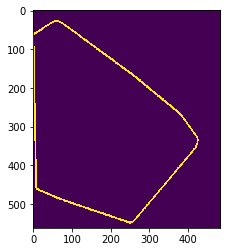

In [42]:
hull_mask = np.zeros(annotation_mask.shape)
hull_mask = cv2.drawContours(hull_mask, [hull], 0, 255, 3)
hull_mask.astype(np.uint8)
plt.imshow(hull_mask)

In preparation for flood filling we will stack this convex hull mask on top of our annotation mask. This now forms a closed contour so we can start filling the mask from a seed region within our new closed annotation contour. 

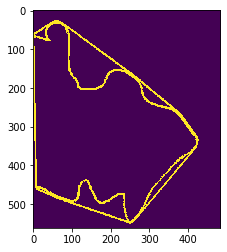

In [46]:
annotation_mask_hulled = cv2.bitwise_or(annotation_mask.astype(np.uint8), hull_mask.astype(np.uint8))
plt.imshow(annotation_mask_hulled)

In [48]:
#Set flood fill seed to be the centroid of the hull
M = cv2.moments(cnt)
centroid_x = int(M['m10']/M['m00'])
centroid_y = int(M['m01']/M['m00'])
print(centroid_x, centroid_y)

202 303


In [49]:
flood_mask = np.zeros((annotation_mask_hulled.shape[0] + 2, annotation_mask_hulled.shape[1] + 2)).astype(np.uint8)
cv2.floodFill(annotation_mask_hulled, flood_mask, (centroid_x, centroid_y), 255)

(112463, array([[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]], dtype=uint8), array([[1, 1, 1, ..., 1, 1, 1],
        [1, 0, 0, ..., 0, 0, 1],
        [1, 0, 0, ..., 0, 0, 1],
        ...,
        [1, 0, 0, ..., 0, 0, 1],
        [1, 0, 0, ..., 0, 0, 1],
        [1, 1, 1, ..., 1, 1, 1]], dtype=uint8), (3, 35, 417, 509))

Now that we've flood filled the mask we can see that we're close to getting our filled in annotation mask. Our stray convex hull line is still there though so let's go and remove it. 

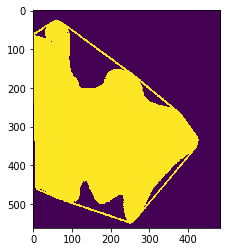

In [51]:
plt.imshow(annotation_mask_hulled)

In [53]:
#remove hull
annotation_mask_filled = cv2.subtract(annotation_mask_hulled.astype(np.uint8), hull_mask.astype(np.uint8))
#Add any accidentally removed pixels from red line
annotation_mask_filled = cv2.bitwise_or(annotation_mask_filled, (annotation_mask*255).astype(np.uint8))

Now that we've removed that line it looks much better

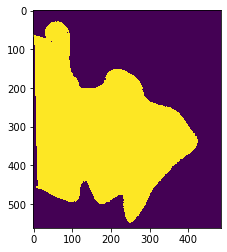

In [551]:
plt.imshow(red_mask_filled)

Let's see what it looks on our annotated image. Not bad!

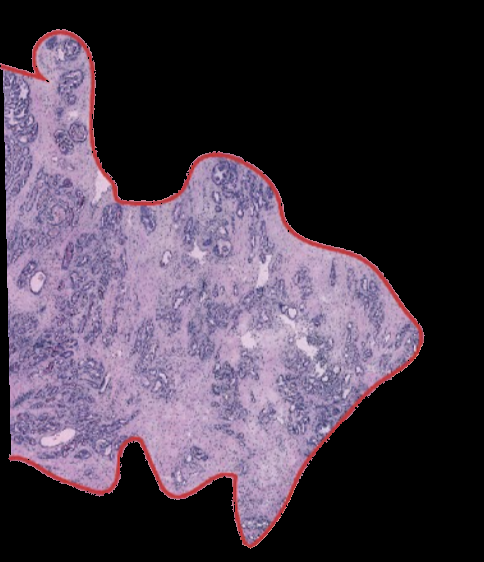

In [54]:
#Show Masked area on annotated image
masked_area = annotation_mask_filled
imshow(cv2.bitwise_and(annotation, annotation, mask = masked_area ))

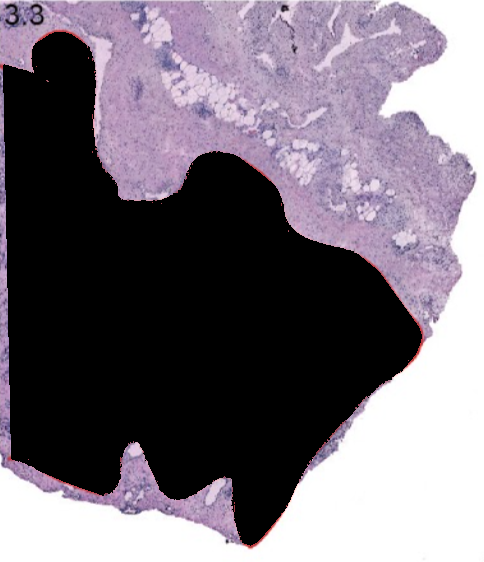

In [55]:
imshow(cv2.bitwise_and(annotation, annotation, mask = cv2.bitwise_not(masked_area)))

### Display Annotation on Whole Slide Image (1/10th size)

In [56]:
wsi_small = cv2.imread(WSI_SMALL_PATH)

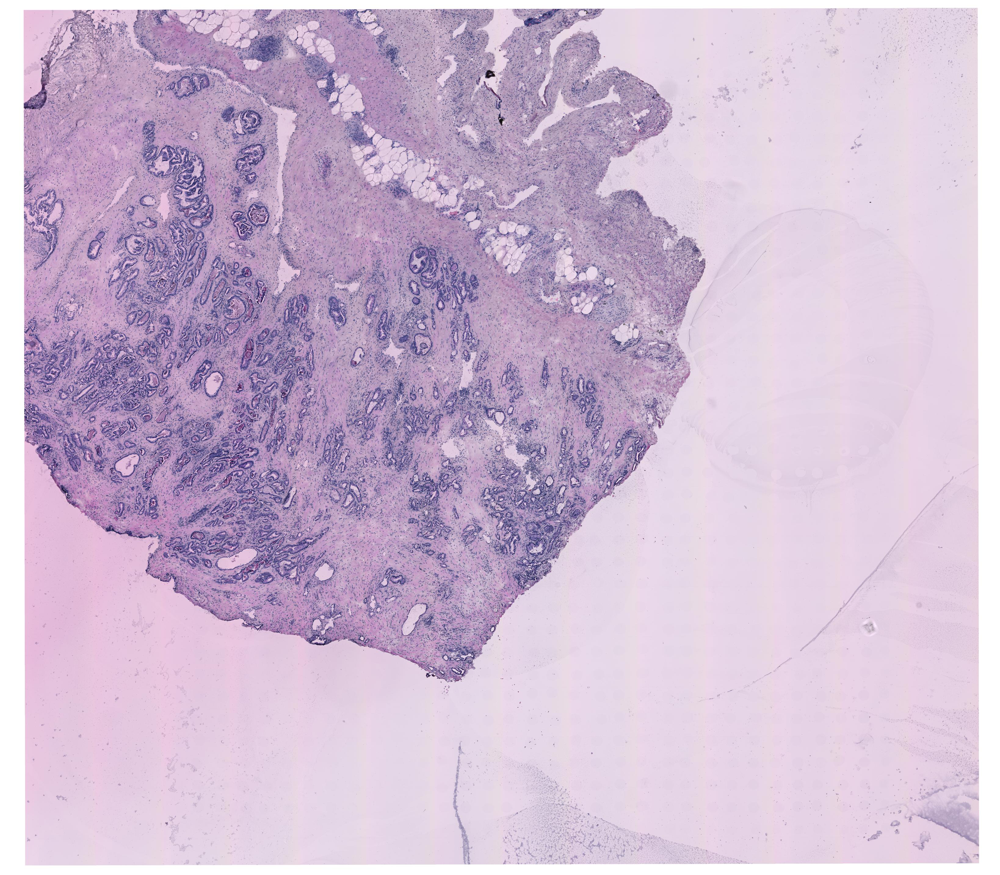

In [57]:
imshow(wsi_small)

Spacell implements image registration to where the annotation image is on the whole slide image. For simplicity, we've put these values here for you. But it you want to see Spacell find these values, running the `spacell_validation.py` script in verbose mode with `-v` and you'll see these values being found in real-time. 

In [59]:
x_offset = 546
y_offset = 201
annotation_scale_factor = 3.737

In [60]:
def scale_img(img, scale_factor):
    """Scales OpenCV images with a constant scale factor
    
    Parameters
    ----------
    img : OpenCV Image (BGR)
    
    scale_factor : float
        Constant factor to scale image by.
        
    Returns
    -------
    scaled_img : OpenCV Image (BGR)
    """
    new_width = int(round(img.shape[1]*scale_factor))
    new_height = int(round(img.shape[0]*scale_factor))
    scaled_img = cv2.resize(img, (new_width, new_height), interpolation = cv2.INTER_CUBIC)
    return scaled_img

With these values, let's see where the red annotation line sits on the whole slide image

In [61]:
red_line = cv2.bitwise_and(annotation, annotation, mask = annotation_mask.astype(np.uint8))
red_line_scaled = scale_img(red_line, annotation_scale_factor)

In [62]:
#Paste the red line onto a copy of the whole slide image
locs = np.nonzero(red_line_scaled)
wsi_annotated = wsi_small.copy()
wsi_annotated[locs[0] + y_offset, locs[1] + x_offset] = red_line_scaled[locs[0], locs[1]]

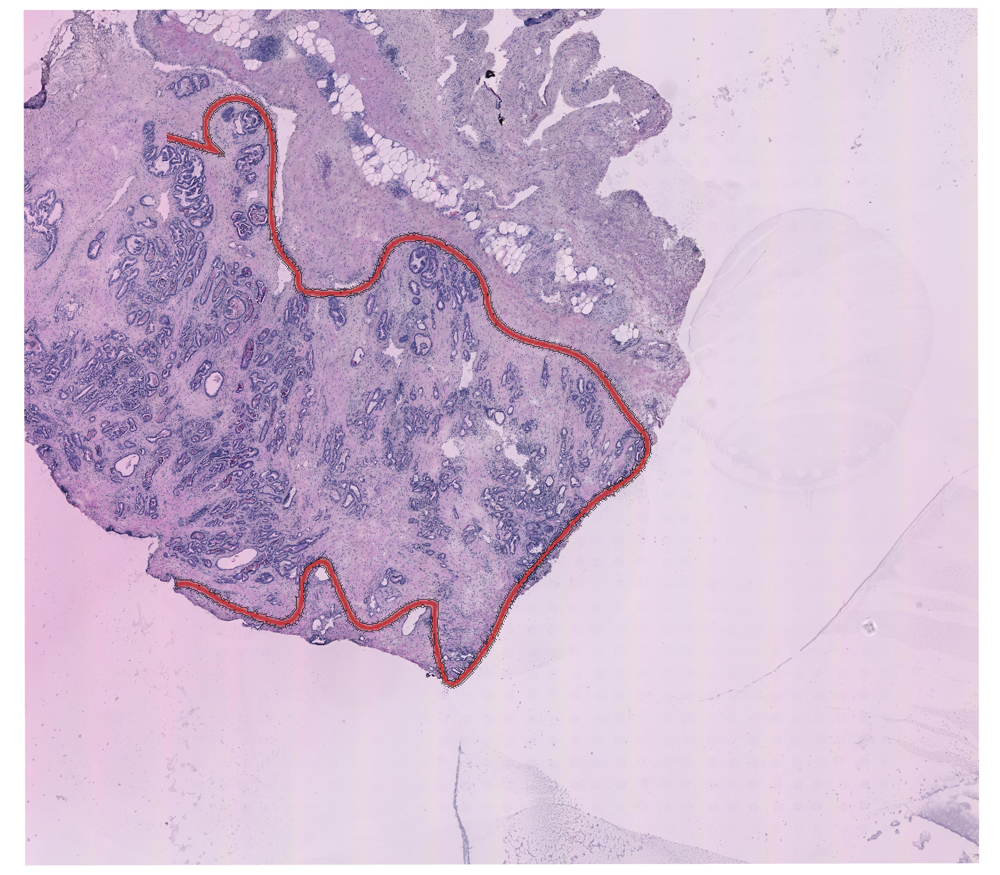

In [63]:
imshow(wsi_annotated)

Looks like the registration worked well! Knowing this, let's move on to generating a mask so we can get on to quantification.

### Generate Mask for WSI (1/10th size)

Similar to how we used the registration results to overlay the red line onto the whole slide image, we can also generate a mask at a whole slide image scale. 
When we move onto the quantification, we can query a spot's coordinates against this mask to see what the spot's true label should be. 

In [64]:
wsi_small_height, wsi_small_width, _ = wsi_small.shape

In [65]:
#Make Blank Mask
wsi_mask = np.zeros((wsi_small_height, wsi_small_width), dtype = np.uint8)

In [67]:
#Scale annotation mask
annotation_mask_scaled = scale_img(annotation_mask_filled, annotation_scale_factor)
#Get Coordinates where the annotation mask is not zero
mask_locs = np.nonzero(annotation_mask_scaled)

In [68]:
wsi_mask[mask_locs[0] + y_offset, mask_locs[1] + x_offset] = annotation_mask_scaled[mask_locs[0], mask_locs[1]]

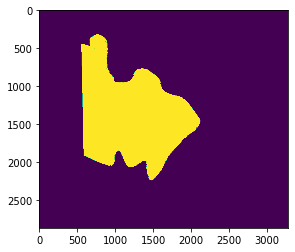

In [69]:
plt.imshow(wsi_mask)

### Display Spots and Annotation on Whole Slide Image (1/10th size)

Let's display our cell type identification predictions to the whole slide image

In [70]:
cluster_preds = pd.read_csv(CLUSTER_PREDICTIONS_PATH, header = 0, sep=',')

In [71]:
cluster_preds = cluster_preds.rename(columns={'label':'pred_colour'})  #Rename 'label' column

In [72]:
cluster_preds.head()

,spot_x,spot_y,pred_colour
0,9.83,9.97,#f02449
1,10.78,9.91,#f02449
2,12.11,9.99,#f02449
3,12.91,9.94,#f02449
4,13.87,9.98,#f02449


In [73]:
cluster_preds.describe()

,spot_x,spot_y
count,501.000000,501.000000
mean,12.130399,13.833892
std,6.062479,6.953312
min,1.730000,1.940000
25%,6.860000,7.980000
50%,12.090000,13.890000
75%,16.930000,19.070000
max,24.830000,28.050000


In [77]:
#These values are derived from the affine transformation matrix file 
spot_x_offset = 514.7984029296876
spot_y_offset = 167.80300345399696
spot_x_scale = 72.20478797940341
spot_y_scale = 72.87928885369535

In [78]:
def transform_spot(cluster_pred, x_offset, y_offset, x_scale, y_scale):
    spot_x = cluster_pred['spot_x']*x_scale + x_offset
    spot_y = cluster_pred['spot_y']*y_scale + y_offset
    return pd.Series({'spot_x': spot_x, 'spot_y': spot_y, 'pred_colour': cluster_pred['pred_colour']})

cluster_preds_scaled = cluster_preds.apply(transform_spot, args = (spot_x_offset, spot_y_offset, spot_x_scale, spot_y_scale), axis = 1)

In [79]:
cluster_preds_scaled.head()

,spot_x,spot_y,pred_colour
0,1224.571469,894.409513,#f02449
1,1293.166017,890.036756,#f02449
2,1389.198385,895.867099,#f02449
3,1446.962216,892.223135,#f02449
4,1516.278812,895.138306,#f02449


In [80]:
def hex2bgr(hex_colour):
    hex_colour = hex_colour.lstrip('#')
    r = int(hex_colour[0:2], 16)
    g = int(hex_colour[2:4], 16)
    b = int(hex_colour[4:6], 16)
    return (b,g,r)

In [81]:
def draw_spot(cluster_pred, img, colour = 'pred_colour', spot_size = 20):
    spot_x = int(round(cluster_pred['spot_x']))
    spot_y = int(round(cluster_pred['spot_y']))
    bgr_colour = hex2bgr(cluster_pred[colour])
    cv2.circle(img, (spot_x, spot_y), spot_size, bgr_colour, -1)

In [82]:
wsi_spotted = wsi_annotated.copy()
_ = cluster_preds_scaled.apply(draw_spot, args = (wsi_spotted,), axis = 1)

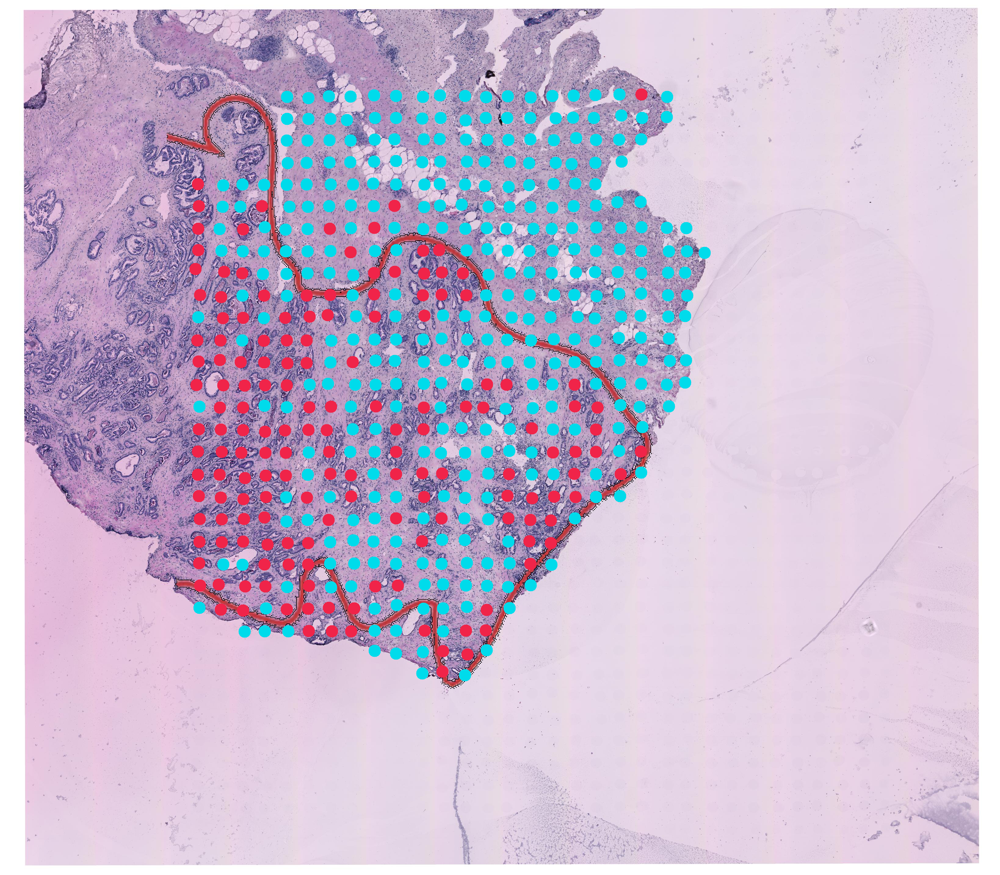

In [83]:
imshow(wsi_spotted)

### Generate True Cluster Labels from Annotation 

In [84]:
cluster_preds_scaled['pred_colour'].unique()

array(['#f02449', '#00dbeb'], dtype=object)

In [85]:
colour2int_dict = {'#f02449':1, '#00dbeb':0}
int2colour_dict = {v: k for k, v in colour2int_dict.items()}
print(int2colour_dict)

{1: '#f02449', 0: '#00dbeb'}


In [86]:
#Convert the predicted colours to integers
cluster_preds_scaled['pred'] = cluster_preds_scaled['pred_colour'].replace(colour2int_dict)

In [87]:
def true_cluster(cluster_pred, mask):
    spot_x = int(round(cluster_pred['spot_x']))
    spot_y = int(round(cluster_pred['spot_y']))
    if mask[spot_y, spot_x] == 0:
        return 0
    else:
        return 1

In [88]:
#Generate the true labels
cluster_preds_scaled['true_label'] = cluster_preds_scaled.apply(true_cluster, args = (wsi_mask,), axis = 1)

In [89]:
#Get the colours for the true labels
cluster_preds_scaled['true_colour'] = cluster_preds_scaled['true_label'].replace(int2colour_dict)

In [90]:
cluster_preds_scaled.head()

,spot_x,spot_y,pred_colour,pred,true_label,true_colour
0,1224.571469,894.409513,#f02449,1,0,#00dbeb
1,1293.166017,890.036756,#f02449,1,1,#f02449
2,1389.198385,895.867099,#f02449,1,1,#f02449
3,1446.962216,892.223135,#f02449,1,1,#f02449
4,1516.278812,895.138306,#f02449,1,1,#f02449


### Clustering Metrics

Now that we have the predicted label and true labels, we can see how well the cell identification worked. Here demonstrate how we calculate accuracy and a confusion matrix but many more options are possible. In Spacell we also provide precision, recall, F-score, ROC AUC and a ROC Curve plot. 

In [91]:
from sklearn.metrics import accuracy_score, confusion_matrix, roc_curve, auc

In [92]:
accuracy_score(cluster_preds_scaled['pred'], cluster_preds_scaled['true_label'])

0.6806387225548902

In [93]:
confusion_matrix(cluster_preds_scaled['true_label'], cluster_preds_scaled['pred'])

array([[195,  14],
       [146, 146]])